# Визуализация графика лосса и работы модели

## Визуализация графика лосса

In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [2]:
loss_history = np.loadtxt('train_losses.txt')

## Загрузка датасета

In [3]:
import h5py
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes.hdf5', 'r')
rgbs_val = np.array(val_data_file['data'])
depths_val = np.array(val_data_file['label'])

In [4]:
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = np.array(test_data_file['data'])
depths_test = np.array(test_data_file['label'])

## Визуализация работы модели

In [5]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '2'

In [6]:
import sys
sys.path.append('/home/kmouraviev')

In [7]:
from tensorflow_resnet.my_batch_normalization import MyBatchNormalization

Using TensorFlow backend.


In [8]:
from keras.models import load_model
model = load_model('model_on_epoch4.hdf5', custom_objects={'MyBatchNormalization': MyBatchNormalization})

/home/kmouraviev/anaconda/envs/tensorflow_py36_1/lib/python3.6/site-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


In [9]:
val_prediction = model.predict(rgbs_val, batch_size=1)
mse = np.mean((val_prediction - depths_val) ** 2)
print('MSE on different scenes:', mse)

MSE on different scenes: 0.46367911057031436


In [10]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

/home/kmouraviev/anaconda/envs/tensorflow_py36_1/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


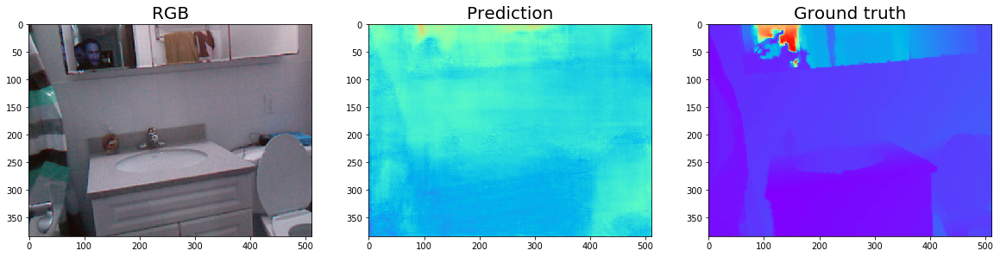

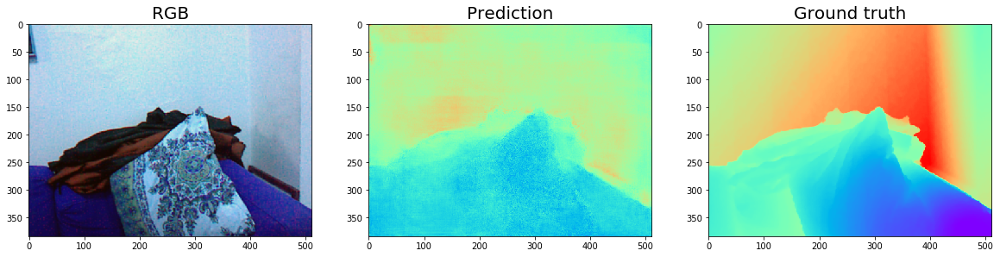

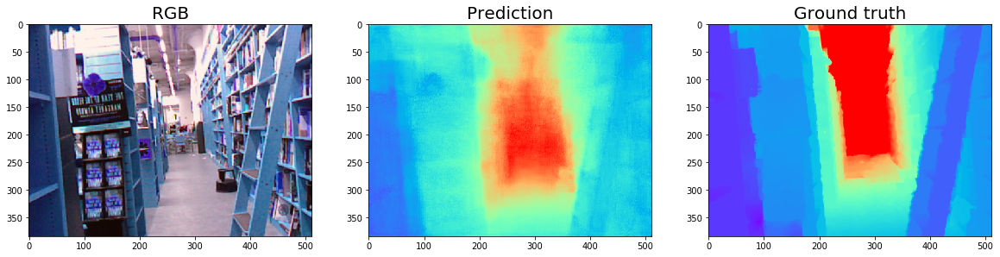

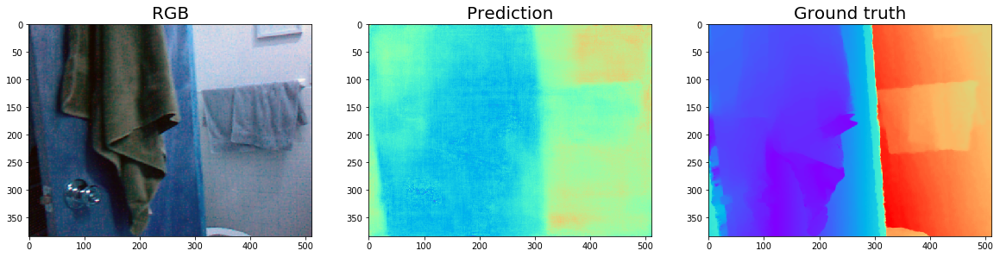

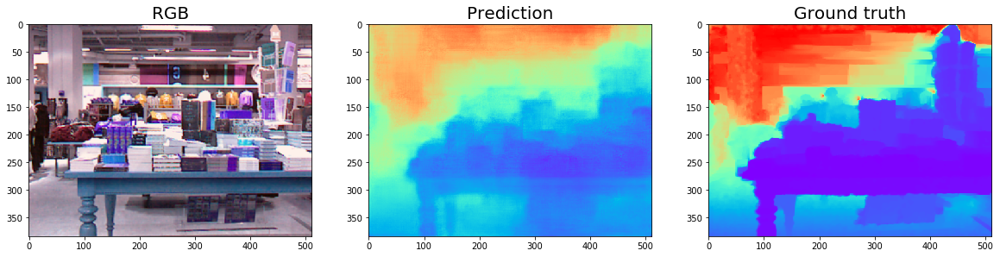

...

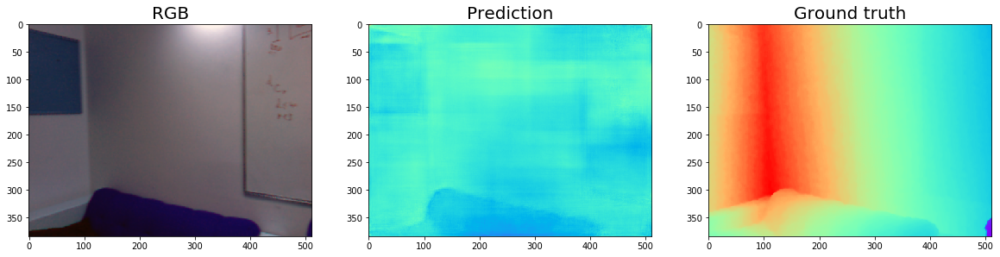

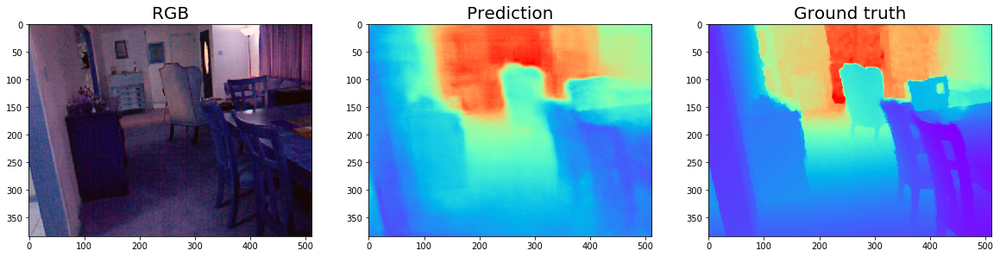

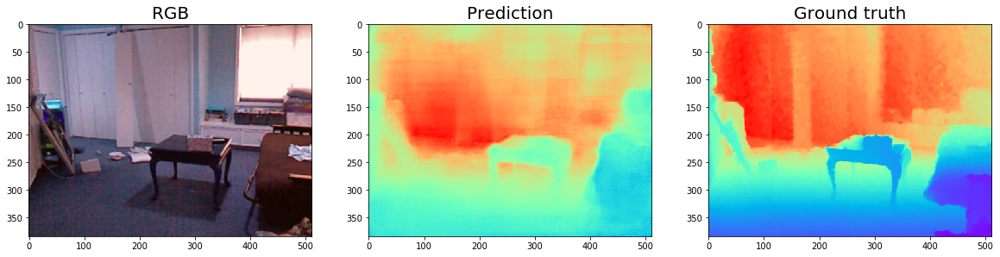

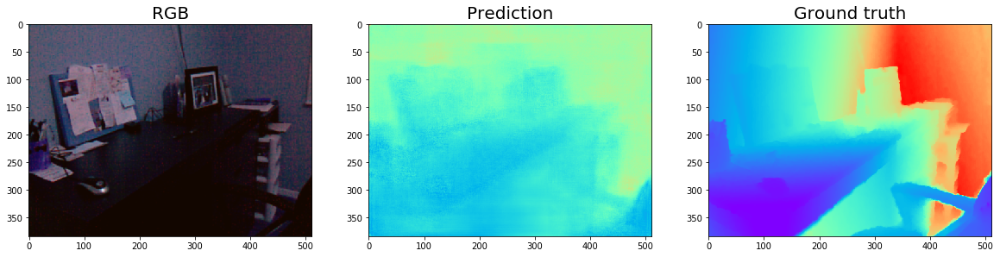

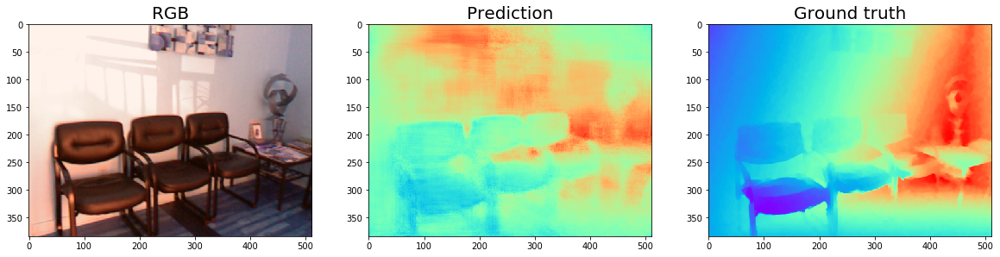

In [11]:
rgbs_val_sample = rgbs_val[::534]
depths_val_sample = depths_val[::534]
val_prediction_sample = model.predict(rgbs_val_sample)
for i in range(len(rgbs_val_sample)):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 3, 1)
    plt.title('RGB', fontsize=20)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(1, 3, 2)
    plt.title('Prediction', fontsize=20)
    plt.imshow(val_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(1, 3, 3)
    plt.title('Ground truth', fontsize=20)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

In [12]:
error = (val_prediction - depths_val) ** 2
relative_error = np.abs(val_prediction - depths_val) / np.maximum(depths_val, 0.5)
target_pixels = (depths_val < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 1, depths_val < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 2, depths_val < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_val > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.47604138129623
Relative_error: 0.5894305636738106


On objects with depth between 1m and 2m:
MSE: 0.24873045331850457
Relative_error: 0.23442215480912268


On objects with depth between 2m and 5m:
MSE: 0.31659522914608257
Relative_error: 0.13604678645073215


On objects with depth > 5m:
MSE: 1.877677806356619
Relative_error: 0.15969524340404867




In [14]:
test_prediction = model.predict(rgbs_test, batch_size=1)
mse = np.mean((test_prediction - depths_test) ** 2)
print('MSE on different collections:', mse)

MSE on different collections: 0.7893046549767924


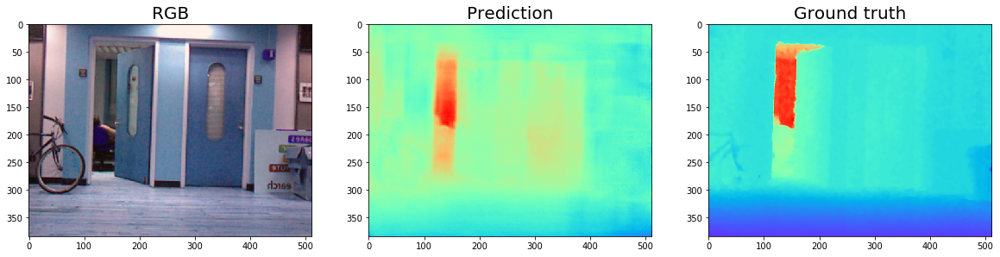

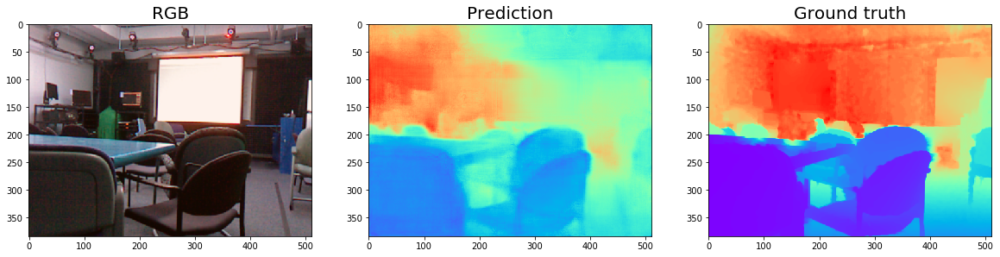

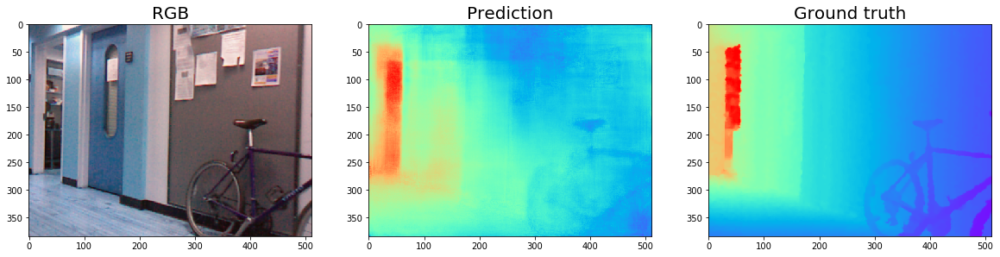

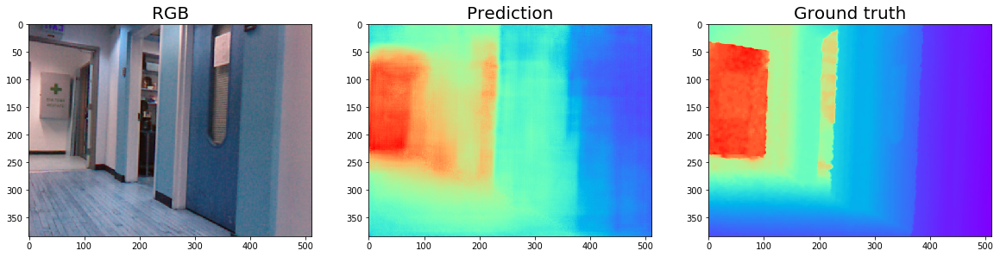

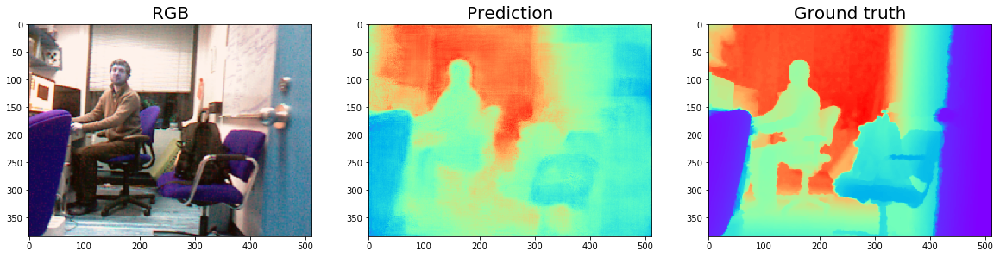

...

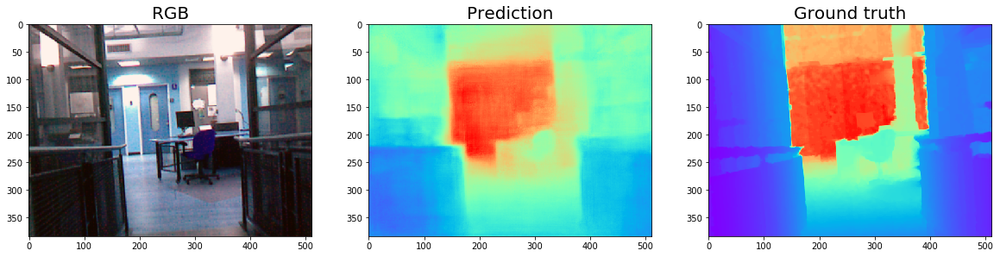

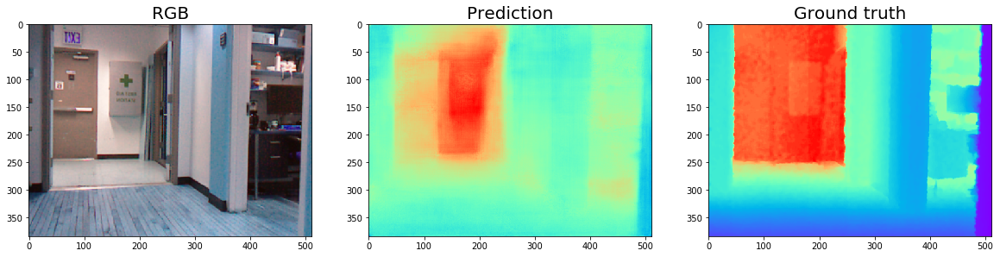

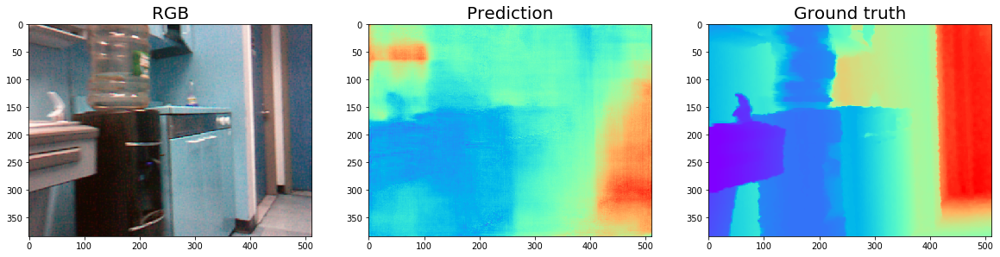

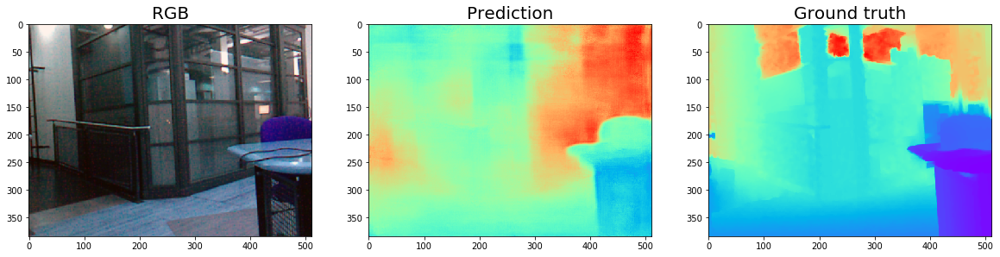

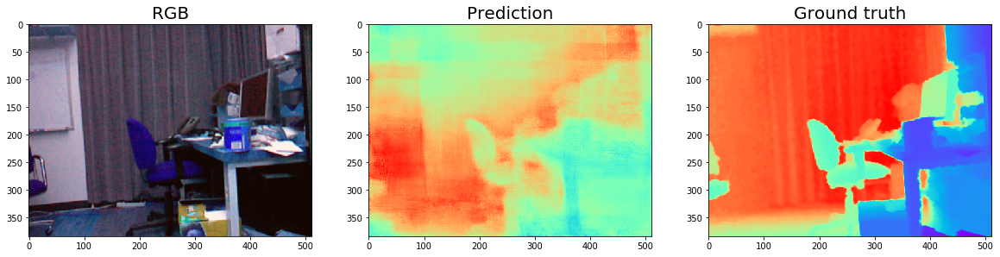

In [15]:
rgbs_test_sample = rgbs_test[::128]
depths_test_sample = depths_test[::128]
test_prediction_sample = model.predict(rgbs_test_sample)
for i in range(len(rgbs_test_sample)):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 3, 1)
    plt.title('RGB', fontsize=20)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(1, 3, 2)
    plt.title('Prediction', fontsize=20)
    plt.imshow(test_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(1, 3, 3)
    plt.title('Ground truth', fontsize=20)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')

In [16]:
error = (test_prediction - depths_test) ** 2
relative_error = np.abs(test_prediction - depths_test) / np.maximum(depths_test, 0.5)
target_pixels = (depths_test < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test > 1, depths_test < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test > 2, depths_test < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_test > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.5831931193104227
Relative_error: 0.7842156538374344


On objects with depth between 1m and 2m:
MSE: 0.3878199281818315
Relative_error: 0.3212220671951141


On objects with depth between 2m and 5m:
MSE: 0.4954349257763598
Relative_error: 0.17757230033232316


On objects with depth > 5m:
MSE: 2.8224515919499105
Relative_error: 0.18842034783989683


